# Spatial Data Science Bootcamp Madrid - September 2023

## Leveraging Python for Spatial Data Science

### Territory optimization

Efficient allocation of resources is crucial for maximizing profitability and customer satisfaction. **Territory optimization** plays a vital role in achieving these objectives by strategically organizing and managing geographic areas to ensure effective coverage and distribution. It applies to different industries and use cases (see list below) and can be run with different data sources (see list below).

#### Industries

Territory optimization is key in many different industries such as:
- On-demand courier service
- Ride sharing and micromobility
- Logistics and transportation
- Field management
- Real Estate
- Urban planning

#### Use cases

Territory optimization can cover different use cases:
- Sales territory management
- Technician territory planning
- Supply Chain Network Optimization
- Electric vechicle charging station allocation
- Asset management

#### Data sources

Territory optimization can be performed using different data sources:
- Historical orders
- Customer locations
- Locations of events (pick up - drop off events, accidents, photos, app usage, weather events, etc.)
- Asset locations
- Resource locations (hubs, distribution centers, sales reps, bike stations, etc.)
- Administrative territories


<img src="images/workshop_image.png" width="1000">


### **Workshop purpose: Territory optimization with Python**

In this workshop, we will cover an end-to-end analysis for territory optimization using Python. **You will learn**:
- **Point pattern analysis**: Discover the power of point pattern analysis and how it can provide valuable insights into the spatial distribution of your business data. Learn how to identify clustering patterns, hotspots, and spatial relationships within your territories.
- **Understanding spatial drivers for your business performance**. Through Geographically Weighted Regression (GWR), explore how to analyze the varying impacts of geographic factors on your sales, customer concentration, or market potential
- **Territory Creation Techniques**: Explore a range of techniques to create optimized territories tailored to your specific business needs.

For this, we will use some of the spatial libraries available for Python, namely:
- [Shapely](https://shapely.readthedocs.io/en/latest/manual.html)
- [Geopandas](https://geopandas.org/en/stable/index.html)
- [Pysal](https://pysal.org/)
- [cartoframes](https://carto.com/developers/cartoframes/)


Let's get started!

## 0. Setup

In [1]:
import contextily
import geopandas as gpd
import matplotlib.pyplot as plt
import networkx as nx
import pickle
import numpy as np
np.float = float
import numpy.ma as ma
import pandas as pd
import seaborn as sns
sns.set(font_scale=1.5)
import zipfile

from cartoframes.viz import *
from h3 import h3
from mgwr.gwr import GWR
from pysal.explore import esda
from pysal.lib import weights
from scipy.spatial.distance import cdist
from shapely import wkt
from shapely.geometry import mapping, Polygon
from sklearn.cluster import AgglomerativeClustering, DBSCAN
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from spglm.family import Poisson
from splot.esda import moran_scatterplot, lisa_cluster
from splot.libpysal import plot_spatial_weights
from spopt.region.maxp import MaxPHeuristic

pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', 200)
sns.set_style('whitegrid')

%matplotlib inline

/opt/homebrew/lib/python3.11/site-packages/libpysal/cg/alpha_shapes.py:38: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @jit
/opt/homebrew/lib/python3.11/site-packages/libpysal/cg/alpha_shapes.py:164: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @jit
/opt/homebrew/lib/python3.11/site-packages/libpysal/cg/alpha_shapes.py:198: NumbaDeprecationWarning: The 'nopyt

In [2]:
def plot_pc_var(var_exp, cum_var_thr = 0.8, textsize = 10, title = ''):
    
    fig, ax = plt.subplots(figsize=(15,6.5),  nrows =1, ncols = 1)
    cum_var_exp = np.cumsum(var_exp)

    ax.bar(np.arange(len(var_exp)) +1, var_exp, alpha=0.5, color = 'mediumblue',
            align='center', label='individual explained variance')
    ax.step(np.arange(len(var_exp)) +1, cum_var_exp, where='mid',  color = 'mediumblue',
             label='cumulative explained variance')
    ax.set_xlabel("Principal component index",fontsize=textsize, weight='bold')
    ax.set_ylabel("",fontsize=textsize)
    ax.yaxis.tick_left()
    ax.xaxis.tick_bottom()  
    ax.tick_params(axis='both', which='major', pad = 10, size = 10, labelsize=textsize)
    ax.tick_params(axis = 'x', labelsize = textsize)

    ax.axhline(y= cum_var_exp[np.where(cum_var_exp > cum_var_thr)[0][0]],c="black",linewidth=1,linestyle = '--',zorder=0)
    #ax.legend(loc='best', fontsize = textsize)

    plt.suptitle(title, x = 0.53, fontsize=textsize, weight='bold')

def plot_pc_corr(data, var_exp,  features, dict_features, nvars = 3, nrows = 3, figsize_w = 30, figsize_h = 20, var_exp_thr = 0.7, textsize = 30, title = 'PC correlation scores with the 5 most correlated variables'):
        
    cum_var_exp = np.cumsum(var_exp)
    ncomponents = np.where(cum_var_exp > var_exp_thr)[0][0]
    pca_corr = []
    for j in range(ncomponents):
        pca_j_corr = []
        for i in features:
            pca_j_corr.append([i,  ma.corrcoef(ma.masked_invalid(data['pc_' + str(j)]), ma.masked_invalid(data[i]))[0,1]])
        pca_j_corr = pd.DataFrame(pca_j_corr, columns=['vars','cor'])
        pca_j_corr = pca_j_corr.iloc[pca_j_corr['cor'].abs().argsort()][::-1]
        pca_j_corr = pca_j_corr.replace(dict_features['description'])
        pca_j_corr.set_index('vars', inplace = True)
        pca_corr.append(pca_j_corr)

    ncols = int(np.ceil(ncomponents/nrows))
    fig, ax = plt.subplots(figsize=(figsize_w,figsize_h),  nrows = nrows, ncols = ncols)
    if ncols > 1:
        l = 0
        for i in range(nrows):
            for j in range(int(np.ceil(ncomponents/nrows))):
                if l < ncomponents:
                    absmax = np.abs(pca_corr[l]["cor"][:nvars].values).max()
                    norm = plt.Normalize(-absmax, absmax)
                    cmap = plt.get_cmap("coolwarm")
                    colors = cmap(norm(np.array(pca_corr[l]["cor"][:nvars],dtype='float64')))
                    pca_corr[l]['cor'][:nvars].plot(kind='barh', color=colors, zorder=2, width=0.9, legend = False, ax = ax[i][j])

                    # Despine
                    ax[i][j].spines['right'].set_visible(False)
                    ax[i][j].spines['top'].set_visible(False)
                    ax[i][j].spines['left'].set_visible(False)
                    ax[i][j].spines['bottom'].set_visible(True)

                    ax[i][j].set_xlabel("", labelpad=15, weight='bold', fontsize=textsize, size=textsize)
                    ax[i][j].set_ylabel("", labelpad=15, weight='bold', fontsize=textsize, size=textsize)
                    ax[i][j].set_title("PC" + str(l),  weight='bold', fontsize=textsize, size=textsize)
                else:
                    fig.delaxes(ax[i][j])
                l = l + 1

        for i in range(nrows):
            for j in range(int(np.ceil(ncomponents/nrows))):
                # Switch off ticks
                ax[i][j].tick_params(axis=u'both', length= 10, bottom="on", top="off", left="off", right="off", labelsize=20)
                ax[i][j].xaxis.set_ticks_position('bottom')
                ax[i][j].yaxis.set_ticks_position('none')  
    else:
        for i in range(nrows):
            absmax = np.abs(pca_corr[i]["cor"][:nvars].values).max()
            norm = plt.Normalize(-absmax, absmax)
            cmap = plt.get_cmap("coolwarm")
            colors = cmap(norm(np.array(pca_corr[i]["cor"][:nvars],dtype='float64')))
            pca_corr[i]['cor'][:nvars].plot(kind='barh', color=colors, zorder=2, width=0.9, legend = False, ax = ax[i])

            # Despine
            ax[i].spines['right'].set_visible(False)
            ax[i].spines['top'].set_visible(False)
            ax[i].spines['left'].set_visible(False)
            ax[i].spines['bottom'].set_visible(True)

            ax[i].set_xlabel("",  labelpad=10, weight='bold', size=textsize)
            ax[i].set_ylabel("",  labelpad=10, weight='bold', size=textsize)
            ax[i].set_title("PC" + str(i),  weight='bold', size=textsize)
            
        for i in range(nrows):
            # Switch off ticks
            ax[i].tick_params(axis=u'both', length= 10, bottom="on", top="off", left="off", right="off", labelsize=20)
            ax[i].xaxis.set_ticks_position('bottom')
            ax[i].yaxis.set_ticks_position('none')         

    plt.suptitle(title, x = 0.53, fontsize=textsize, weight='bold')
    fig.tight_layout(rect=[0, 0.03, 1, 0.95])

## 1. Data Loading

### 1.1. Locations

This dataset contains event locations. In our case, they represent order delivery locations, but remember they could be data related to any of the industries or use cases mentioned above.

- *Source*: Simulated data
- *Format*: CSV
- *File path*: `data/order_history.csv`

In [3]:
orders = pd.read_csv('data/order_history.csv')
orders['geometry'] = gpd.points_from_xy(orders['lon'], orders['lat'])
orders = gpd.GeoDataFrame(orders, crs='epsg:4326')
orders.head()

,order_id,lat,lon,geometry
0,0,40.419263,-3.719897,POINT (-3.71990 40.41926)
1,1,40.417093,-3.713083,POINT (-3.71308 40.41709)
2,2,40.416763,-3.716036,POINT (-3.71604 40.41676)
3,3,40.419703,-3.712296,POINT (-3.71230 40.41970)
4,4,40.419013,-3.719572,POINT (-3.71957 40.41901)


In [4]:
orders.shape

(10121, 4)

In [5]:
Map(Layer(orders))

### 1.2. Census data

Spain recently released partial results of the 2021 census. In particular, the released the following indices at the census tract level:

<img src="images/census_variables.png"  width="1000">

- *Source*: [INE](https://www.ine.es/dyngs/INEbase/es/operacion.htm?c=Estadistica_C&cid=1254736176992&menu=resultados&idp=1254735572981#!tabs-1254736195781)
- *Format*: CSV
- *File path*: `data/C2021_Indicadores.csv` & `data/indicadores_desc.csv`

In [6]:
census = pd.read_csv('data/C2021_Indicadores.csv', dtype={'ccaa':str, 'CPRO':str, 'CMUN':str, 'dist':str, 'secc':str})
census.head()

,ccaa,CPRO,CMUN,dist,secc,t1_1,t2_1,t2_2,t3_1,t4_1,t4_2,t4_3,t5_1,t6_1,t7_1,t8_1,t9_1,t10_1,t11_1,t12_1,t13_1,t14_1,t15_1,t16_1
0,01,04,001,01,001,1260,0.4857,0.5143,49.0008,0.1048,0.6008,0.2944,0.0984,0.0984,0.0833,0.0762,0.2163,0.1951,0.3768,0.4681,0.0363,0.2899,0.1507,0.0629
1,01,04,002,01,001,1212,0.4719,0.5281,48.9695,0.0891,0.6287,0.2822,0.0941,0.0899,0.0598,0.0498,0.1812,0.2052,0.3614,0.4547,0.0444,0.2754,0.1739,0.0571
2,01,04,003,01,001,869,0.5086,0.4914,44.5984,0.1208,0.6789,0.2002,0.1231,0.1277,0.0759,0.0628,0.2356,0.1576,0.4686,0.5563,0.0183,0.1728,0.1728,0.0903
3,01,04,003,01,002,1765,0.5008,0.4992,39.7705,0.1773,0.6929,0.1297,0.0793,0.0782,0.0482,0.0386,0.2231,0.1258,0.5455,0.6240,0.0179,0.1219,0.1701,0.0861
4,01,04,003,01,003,2239,0.5092,0.4908,37.5775,0.1894,0.7034,0.1072,0.1215,0.1170,0.0562,0.0435,0.1730,0.1432,0.5802,0.6771,0.0253,0.1047,0.1273,0.0837


In [7]:
census.shape

(36333, 24)

#### Census variable description

In [8]:
census_var_df = pd.read_csv('data/indicadores_desc.csv')
census_var_df[census_var_df['Tabla'].isin(census.columns)]

,Tabla,Indicador
0,t1_1,Total Personas
1,t2_1,Porcentaje de mujeres
2,t2_2,Porcentaje de hombres
3,t3_1,Edad media
4,t4_1,Porcentaje de personas menores de 16 años
5,t4_2,Porcentaje de personas entre 16 (incluido) y 64 (incluido) años
6,t4_3,Porcentaje de personas con más de 64 años
7,t5_1,Porcentaje extranjeros
8,t6_1,Porcentaje personas nacidas en el extranjero
9,t7_1,Porcentaje personas cursando estudios superiores (escur =08 09 10 11 12 ) sobre población de 16 y más


In [9]:
census_dict = census_var_df[census_var_df['Tabla'].isin(census.columns)].\
                rename(columns={'Tabla':'vars','Indicador':'description'}).set_index('vars').to_dict()

In [10]:
predictors_dict = {'description': {'t1_1': 'Total Personas',
  't2_1': 'Porcentaje de mujeres',
  't2_2': 'Porcentaje de hombres',
  't3_1': 'Edad media',
  't4_1': 'Porcentaje de personas menores de 16 años',
  't4_2': 'Porcentaje de personas entre 16 (incluido) y 64 (incluido) años',
  't4_3': 'Porcentaje de personas con más de 64 años',
  't5_1': 'Porcentaje extranjeros',
  't6_1': 'Porcentaje personas nacidas en el extranjero',
  't7_1': 'Porcentaje personas cursando estudios superiores (escur =08 09 10 11 12 ) sobre población de 16 y más',
  't8_1': 'Porcentaje de personas cursando estudios universitarios (escur = 09 10 11 12 ) sobre población de 16 y más',
  't9_1': 'Porcentaje personas con estudios superiores  (esreal_cneda=08 09 10 11 12) sobre población de 16 y más',
  't10_1': 'Porcentaje de población parada sobre población activa= Parados /Activos',
  't11_1': 'Porcentaje de población ocupada sobre población de 16 y más =Ocupados/ Pob 16 y +',
  't12_1': 'Porcentaje de población activa sobre población de 16 y más= Activos / Pob 16 y +',
  't13_1': 'Porcentaje de población pensionista por invalidez sobre población de 16 y más=Pensionistas por invalidez / Pob 16 y +',
  't14_1': 'Porcentaje de población pensionista por jubilación sobre población de 16 y más=Pensionistas por jubilación / Pob 16 y +',
  't15_1': 'Porcentaje de población en otra situación de inactividad sobre población de 16 y más=Población en otra situación de inactividad / Pob 16 y +',
  't16_1': 'Porcentaje de población estudiante sobre población de 16 y más=Estudiantes / Pob 16 y +'}}

### 1.3. Census section geometries

- *Source*: [INE](https://www.ine.es/dyngs/INEbase/es/operacion.htm?c=Estadistica_C&cid=1254736176992&menu=resultados&idp=1254735572981#!tabs-1254736195781)
- *Format*: GeoJSON
- *File path*: `data/census_tracts_madrid.geojson`

In [11]:
ct = gpd.read_file('data/census_tracts_madrid.geojson', crs='epsg:4326').rename(columns={'CCA':'ccaa', 'CDIS':'dist', 'CSEC':'secc'})
ct.head(2)

,CUSEC,CUMUN,secc,dist,CMUN,CPRO,ccaa,CUDIS,CLAU2,NPRO,NCA,CNUT0,CNUT1,CNUT2,CNUT3,ESTADO,OBS,NMUN,geometry
0,2800101001,28001,001,01,001,28,13,2800101,28001,Madrid,Comunidad de Madrid,ES,3,0,0,I,NaN,"Acebeda, La","POLYGON ((-3.64316 41.12063, -3.64166 41.12010, -3.64077 41.12002, -3.63993 41.12010, -3.63795 41.12063, -3.63607 41.12077, -3.63492 41.12072, -3.63345 41.12089, -3.63243 41.12080, -3.63115 41.120..."
1,2800201001,28002,001,01,002,28,13,2800201,28002,Madrid,Comunidad de Madrid,ES,3,0,0,I,NaN,Ajalvir,"POLYGON ((-3.46946 40.53960, -3.46854 40.53945, -3.46904 40.53834, -3.46994 40.53575, -3.47085 40.53315, -3.46853 40.53280, -3.46869 40.53126, -3.46685 40.53095, -3.46452 40.52853, -3.46279 40.528..."


We're only interested in Madrid city census tracts.

In [12]:
census = census.merge(ct.loc[ct['NMUN'] == 'Madrid', ['ccaa', 'CPRO', 'CMUN', 'dist', 'secc', 'geometry']],
                      on=['ccaa', 'CPRO', 'CMUN', 'dist', 'secc'])

In [13]:
census.shape

(2443, 25)

#### For visualizing the dataset we can optionally transform it into a GeoDataFrame

In [14]:
census = gpd.GeoDataFrame(census, crs='epsg:4326')

In [15]:
Map(Layer(census, geom_col='geometry'))

### 1.4. Madrid boundary

This dataset can be useful for filtering and visualization purposes.

- *Source*: [Geoportal del Ayuntamiento de Madrid](https://geoportal.madrid.es/IDEAM_WBGEOPORTAL/dataset.iam?id=63dc1627-762b-11e9-861d-ecb1d753f6e8)
- *Format*: shapefile
- *File path*: `data/Termino_Municipal/Termino_municipal.shp`

In [16]:
with zipfile.ZipFile('./data/Termino_Municipal.zip', 'r') as zip_ref:
    zip_ref.extractall('./data/')

In [17]:
madrid = gpd.read_file('data/Termino_Municipal/Termino_municipal.shp', crs='epsg:32630')
madrid = madrid.to_crs('epsg:4326')
madrid

,OBJECTID,Shape_Leng,Shape_Area,TM,geometry
0,1,174177.932753,6.044551e+08,Madrid,"POLYGON ((-3.64447 40.63810, -3.64245 40.63805, -3.64203 40.63811, -3.64137 40.63823, -3.64088 40.63831, -3.64043 40.63839, -3.64017 40.63843, -3.64011 40.63844, -3.64001 40.63844, -3.63995 40.638..."


In [18]:
Map(Layer(madrid))

## 2. Point Pattern Analysis

When points are seen as events that could take place in several locations but only happen in a few of them, a collection of such events is called a point pattern.

Point pattern analysis is thus concerned with the visualization, description, statistical characterization, and modeling of point patterns, trying to understand the generating process that gives rise and explains the observed data. Common questions in this domain include:
- What does the pattern look like?
- What is the nature of the distribution of points?
- Is there any structure in the way locations are arranged over space? That is, are events clustered? or are they dispersed?
- Why do events occur in those places and not in others?


In [19]:
orders.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 10121 entries, 0 to 10120
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   order_id  10121 non-null  int64   
 1   lat       10121 non-null  float64 
 2   lon       10121 non-null  float64 
 3   geometry  10121 non-null  geometry
dtypes: float64(2), geometry(1), int64(1)
memory usage: 316.4 KB


### 2.1. Showing patterns as dots in a scatter plot

We can start by lotting a joint plot combining a lat/lon scatter plot with a histogram. This helps identify where events concentrate.

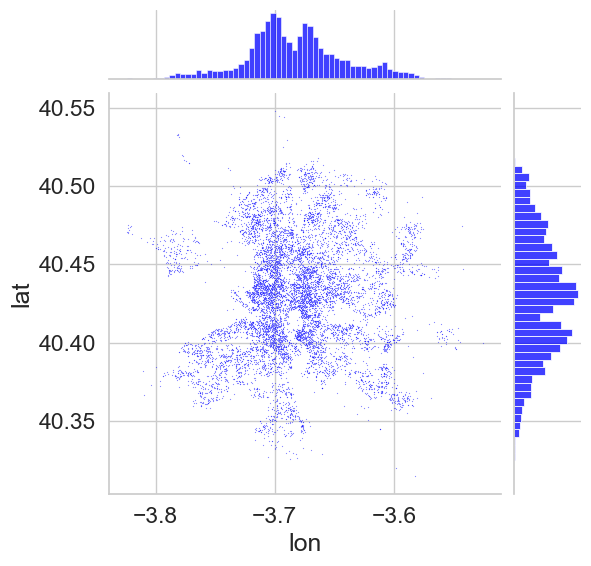

In [20]:
sns.jointplot(x='lon', y='lat', data=orders, s=0.75, color='blue', alpha=0.5)

We can add geographic context by adding a map to the joint plot by using `contextily`.

An interesting pattern we can identify on the longitude histogram is that the bimodal distribution is explained by the presence of large parks/green areas in the central part of the city.

/var/folders/r6/833vqlws5c1dzd7d5r447kdc0000gp/T/ipykernel_48271/1509973278.py:10: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


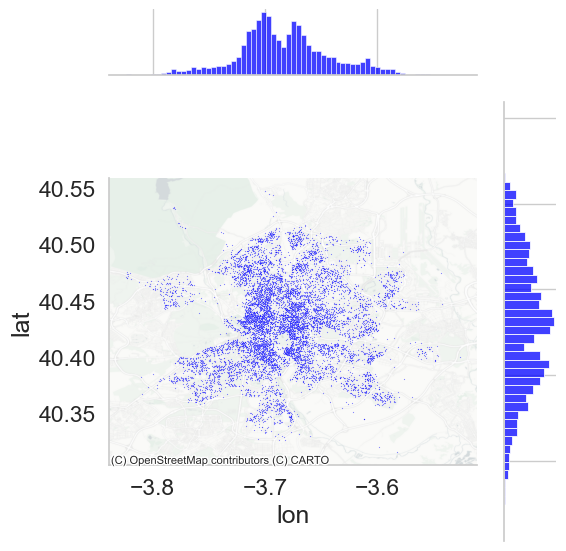

In [21]:
joint_axes = sns.jointplot(x='lon', y='lat', data=orders, s=0.75, color='blue', alpha=0.5)

contextily.add_basemap(
    joint_axes.ax_joint,
    crs="epsg:4326",
    source=contextily.providers.CartoDB.PositronNoLabels
)

plt.grid()
plt.tight_layout()

### 2.2. Kernel density estimation

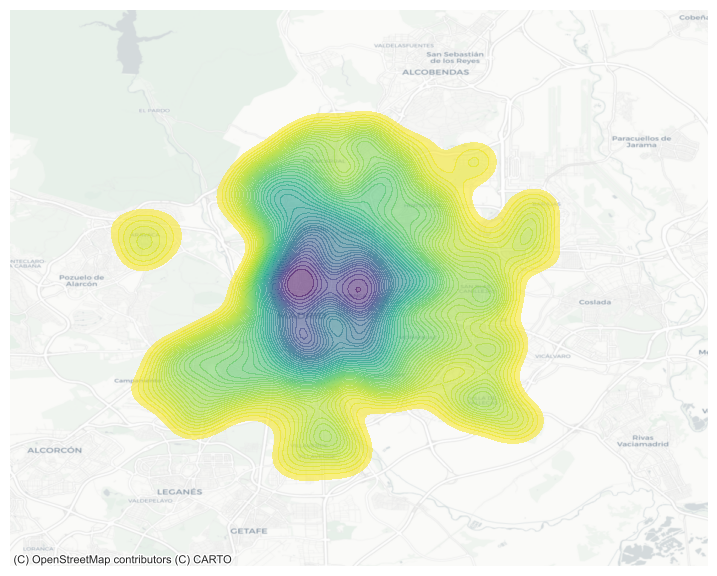

In [22]:
fig, ax = plt.subplots(1, figsize=(9, 9))

# Generate and add KDE with a shading of 50 gradients
# coloured contours, 75% of transparency,
sns.kdeplot(
    x='lon', 
    y='lat',
    data=orders,
    n_levels=50,
    fill=True,
    alpha=0.55,
    cmap="viridis_r",
)
# Add basemap
contextily.add_basemap(
    ax, 
    crs="epsg:4326",
    source=contextily.providers.CartoDB.Positron
)
# Remove axes
ax.set_axis_off()

### 2.3. Showing patterns on a map through visualization capabilities

If we plot all locations on a map without applying any styling, it becomes challenging to discern whether there is an existing point pattern.

In [23]:
Map(Layer(orders,
          style=basic_style(color='#F2B701', opacity=0.25, stroke_width=0, size=3),
          widgets=[histogram_widget('lat', title='Latitude', buckets=50),
                   histogram_widget('lon', title='Longitude', buckets=50)]
         ),
    basemap=basemaps.darkmatter
   )

### 2.4. Density patterns using H3

[Hierarchical grid systems](https://docs.carto.com/data-and-analysis/analytics-toolbox-for-bigquery/key-concepts/spatial-indexes), such as Quadbin, H3, and S2, are an essential tool for analysing large spatial datasets, especially when dealing with data sources in different spatial aggregations. These systems are based on geospatial indexes that provide a direct relationship between grid cells at different resolutions, enabling extremely performant spatial operations.

We'll use [Python H3](https://github.com/uber/h3-py) to analyze density patterns.

We start by assigning the corresponding h3 index to every point location.

In [24]:
orders['h3'] = orders.apply(lambda row: h3.geo_to_h3(row['lat'], row['lon'], 9), axis=1)
orders.head()

,order_id,lat,lon,geometry,h3
0,0,40.419263,-3.719897,POINT (-3.71990 40.41926),89390cb1a37ffff
1,1,40.417093,-3.713083,POINT (-3.71308 40.41709),89390cb1b53ffff
2,2,40.416763,-3.716036,POINT (-3.71604 40.41676),89390cb1a27ffff
3,3,40.419703,-3.712296,POINT (-3.71230 40.41970),89390cb1bcfffff
4,4,40.419013,-3.719572,POINT (-3.71957 40.41901),89390cb1a37ffff


Next, we aggregate counts by h3 index and get the corresponding geometries.

In [25]:
orders_agg = orders.groupby('h3').agg({'lat':'count'}).reset_index().rename(columns={'lat':'count'})
orders_agg['geometry'] = orders_agg['h3'].apply(lambda x: Polygon(h3.h3_to_geo_boundary(x, geo_json=True)))
orders_agg

,h3,count,geometry
0,89390ca0003ffff,3,"POLYGON ((-3.618070590423171 40.374392148893435, -3.6198328158333544 40.37317652790111, -3.6193654280529284 40.37132495112482, -3.617135928365721 40.37068901296749, -3.6153737596119986 40.37190460..."
1,89390ca0007ffff,7,"POLYGON ((-3.6140787898359226 40.37497169724194, -3.6158410338884504 40.37375616420562, -3.6153737596119986 40.37190460505704, -3.613144354786667 40.37126859658002, -3.6113821674043307 40.37248410..."
2,89390ca000bffff,2,"POLYGON ((-3.6193654280529284 40.37132495112482, -3.621127578159873 40.37010927108527, -3.6206601719326144 40.368257681795825, -3.618430729092784 40.36762179016964, -3.6166686356334203 40.36883744..."
3,89390ca000fffff,4,"POLYGON ((-3.6153737596119986 40.37190460505704, -3.617135928365721 40.37068901296749, -3.6166686356334203 40.368837441302844, -3.6144392876420497 40.368201479360096, -3.612677175549604 40.3694170..."
4,89390ca0013ffff,4,"POLYGON ((-3.6207676680050227 40.37687967402992, -3.6225299500668675 40.37566402413293, -3.622062467224967 40.373812442258064, -3.6198328158333544 40.37317652790111, -3.618070590423171 40.37439214..."
...,...,...,...
1839,89390cbae63ffff,2,"POLYGON ((-3.7915897057353622 40.380763646848905, -3.7933518653789617 40.37954453959737, -3.7928793418255027 40.37769228086096, -3.7906447722142866 40.377059146629406, -3.788882668677167 40.378278..."
1840,89390cbae67ffff,1,"POLYGON ((-3.787592899552735 40.381349485498994, -3.7893550786441605 40.38013046624248, -3.788882668677167 40.37827822476049, -3.7866481932050133 40.37764501979697, -3.7848860702339095 40.37886400..."
1841,89390cbae73ffff,1,"POLYGON ((-3.79429698993335 40.38324904931926, -3.7960592056784415 40.3820299129454, -3.79558658660401 40.38017764946066, -3.7933518653789617 40.37954453959737, -3.7915897057353622 40.380763646848..."
1842,89390cbae77ffff,1,"POLYGON ((-3.7902999760079275 40.383834941458375, -3.792062211214699 40.38261589308496, -3.7915897057353622 40.380763646848905, -3.7893550786441605 40.38013046624248, -3.787592899552735 40.3813494..."


In order to get interesting insights, we analyse the distribution of aggregated orders.

<Axes: xlabel='count', ylabel='Count'>

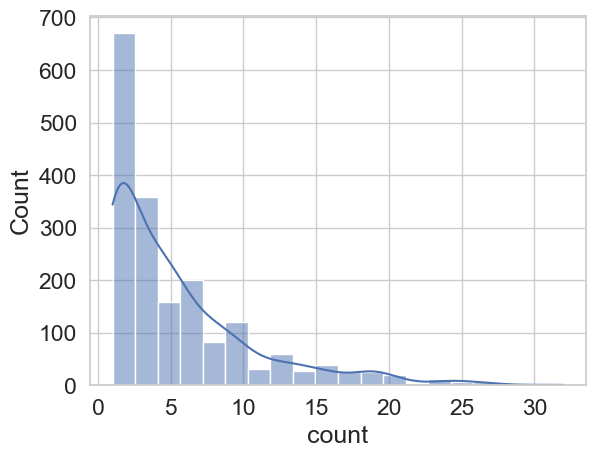

In [26]:
sns.histplot(orders_agg['count'], kde=True, bins=20)

In [27]:
orders_agg['count'].describe(percentiles=[0.25, 0.75, 0.9, 0.95, 0.99])

count    1844.000000
mean        5.488612
std         5.166189
min         1.000000
25%         2.000000
50%         4.000000
75%         7.000000
90%        13.000000
95%        17.000000
99%        24.000000
max        32.000000
Name: count, dtype: float64

Let's now visualize it on a map. Check out [CARTO palettes](https://carto.com/carto-colors/) for making your map more appealing!

In [28]:
Map(Layer(orders_agg, geom_col='geometry', 
          style=color_bins_style('count', breaks=[2, 4, 7, 17], opacity=0.85, palette=palettes.purpor)))

### 2.5. Density patterns using census tracts

In [29]:
orders.head()

,order_id,lat,lon,geometry,h3
0,0,40.419263,-3.719897,POINT (-3.71990 40.41926),89390cb1a37ffff
1,1,40.417093,-3.713083,POINT (-3.71308 40.41709),89390cb1b53ffff
2,2,40.416763,-3.716036,POINT (-3.71604 40.41676),89390cb1a27ffff
3,3,40.419703,-3.712296,POINT (-3.71230 40.41970),89390cb1bcfffff
4,4,40.419013,-3.719572,POINT (-3.71957 40.41901),89390cb1a37ffff


In [30]:
census.head()

,ccaa,CPRO,CMUN,dist,secc,t1_1,t2_1,t2_2,t3_1,t4_1,t4_2,t4_3,t5_1,t6_1,t7_1,t8_1,t9_1,t10_1,t11_1,t12_1,t13_1,t14_1,t15_1,t16_1,geometry
0,13,28,079,01,001,1159,0.5203,0.4797,47.3106,0.0863,0.6721,0.2416,0.1648,0.2381,0.0482,0.0425,0.6364,0.1129,0.4674,0.5269,0.0113,0.1813,0.2304,0.0585,"POLYGON ((-3.71113 40.42075, -3.71176 40.42067, -3.71193 40.42064, -3.71189 40.42059, -3.71113 40.41990, -3.71086 40.41969, -3.71123 40.41949, -3.71145 40.41949, -3.71156 40.41949, -3.71157 40.419..."
1,13,28,079,01,002,888,0.5236,0.4764,43.2252,0.0484,0.8018,0.1498,0.2432,0.3660,0.0639,0.0627,0.6071,0.1182,0.5385,0.6107,0.0095,0.1160,0.2166,0.0521,"POLYGON ((-3.71015 40.42294, -3.71030 40.42282, -3.71057 40.42257, -3.71061 40.42252, -3.71067 40.42249, -3.71011 40.42165, -3.71001 40.42150, -3.70980 40.42123, -3.70965 40.42106, -3.70945 40.420..."
2,13,28,079,01,003,1743,0.4968,0.5032,43.7499,0.0700,0.7631,0.1670,0.2731,0.3798,0.0660,0.0592,0.5663,0.1126,0.5009,0.5645,0.0148,0.1370,0.2332,0.0574,"POLYGON ((-3.70794 40.42153, -3.70779 40.42144, -3.70719 40.42106, -3.70702 40.42095, -3.70686 40.42085, -3.70641 40.42056, -3.70607 40.42035, -3.70595 40.42032, -3.70623 40.42020, -3.70632 40.420..."
3,13,28,079,01,004,1273,0.5185,0.4815,46.5475,0.0731,0.7023,0.2247,0.1634,0.2577,0.0619,0.0559,0.6424,0.1284,0.4831,0.5542,0.0136,0.1754,0.2042,0.0585,"POLYGON ((-3.71025 40.42079, -3.71020 40.42073, -3.70984 40.42039, -3.70981 40.42037, -3.70978 40.42035, -3.70933 40.41992, -3.70928 40.41988, -3.70931 40.41986, -3.70933 40.41984, -3.70934 40.419..."
4,13,28,079,01,006,1712,0.4907,0.5093,46.5736,0.0718,0.7214,0.2068,0.1863,0.2769,0.0604,0.0516,0.6834,0.1005,0.5179,0.5758,0.0082,0.1687,0.1951,0.0585,"POLYGON ((-3.70815 40.41906, -3.70818 40.41895, -3.70818 40.41894, -3.70822 40.41886, -3.70846 40.41839, -3.70847 40.41835, -3.70851 40.41828, -3.70852 40.41826, -3.70874 40.41790, -3.70876 40.417..."


1. Assign every point location to its corresponding census tract through a spatial join.
2. Aggregate counts at the census tract level.

#### Aggregate by census tract

In [31]:
ct_mad = census[['ccaa', 'CPRO', 'CMUN', 'dist', 'secc', 'geometry']]

orders_ct = ct_mad.sjoin(orders, how='left').groupby(['ccaa', 'CPRO', 'CMUN', 'dist', 'secc']).agg({'order_id':'count', 'geometry':'first'})\
                .reset_index().rename(columns={'order_id':'count'})

orders_ct.head()

,ccaa,CPRO,CMUN,dist,secc,count,geometry
0,13,28,079,01,001,7,"POLYGON ((-3.71113 40.42075, -3.71176 40.42067, -3.71193 40.42064, -3.71189 40.42059, -3.71113 40.41990, -3.71086 40.41969, -3.71123 40.41949, -3.71145 40.41949, -3.71156 40.41949, -3.71157 40.419..."
1,13,28,079,01,002,4,"POLYGON ((-3.71015 40.42294, -3.71030 40.42282, -3.71057 40.42257, -3.71061 40.42252, -3.71067 40.42249, -3.71011 40.42165, -3.71001 40.42150, -3.70980 40.42123, -3.70965 40.42106, -3.70945 40.420..."
2,13,28,079,01,003,6,"POLYGON ((-3.70794 40.42153, -3.70779 40.42144, -3.70719 40.42106, -3.70702 40.42095, -3.70686 40.42085, -3.70641 40.42056, -3.70607 40.42035, -3.70595 40.42032, -3.70623 40.42020, -3.70632 40.420..."
3,13,28,079,01,004,7,"POLYGON ((-3.71025 40.42079, -3.71020 40.42073, -3.70984 40.42039, -3.70981 40.42037, -3.70978 40.42035, -3.70933 40.41992, -3.70928 40.41988, -3.70931 40.41986, -3.70933 40.41984, -3.70934 40.419..."
4,13,28,079,01,006,6,"POLYGON ((-3.70815 40.41906, -3.70818 40.41895, -3.70818 40.41894, -3.70822 40.41886, -3.70846 40.41839, -3.70847 40.41835, -3.70851 40.41828, -3.70852 40.41826, -3.70874 40.41790, -3.70876 40.417..."


Text(0.5, 1.0, 'Census Tract Density Analysis')

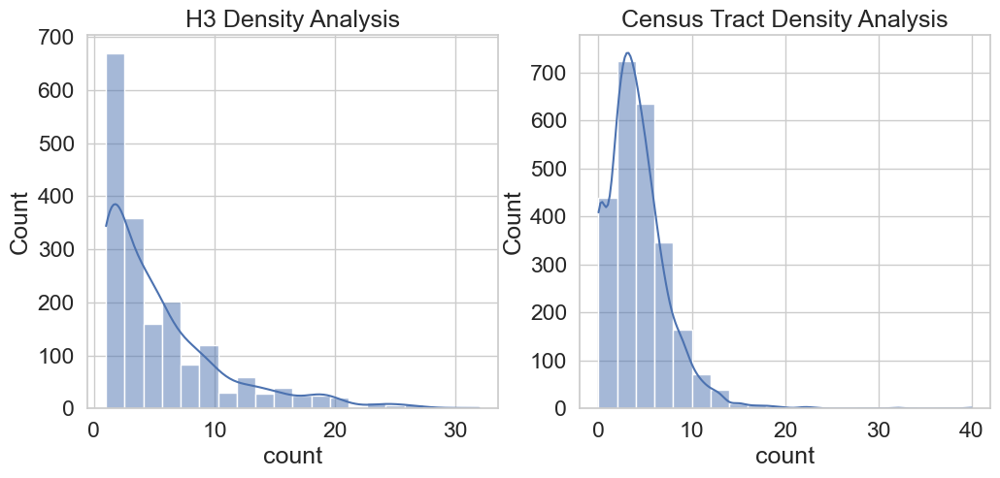

In [32]:
fig, axs = plt.subplots(1, 2, figsize=(12, 5))

sns.histplot(orders_agg['count'], kde=True, bins=20, ax=axs[0])
axs[0].set_title('H3 Density Analysis')
sns.histplot(orders_ct['count'], kde=True, bins=20, ax=axs[1])
axs[1].set_title('Census Tract Density Analysis')

In [33]:
percentiles=[0.25, 0.75, 0.9, 0.95, 0.99]
pd.concat([orders_agg['count'].rename('h3_count').describe(percentiles=percentiles), 
           orders_ct['count'].rename('ct_count').describe(percentiles=percentiles)], axis=1)

,h3_count,ct_count
count,1844.000000,2443.000000
mean,5.488612,4.142857
std,5.166189,3.229493
min,1.000000,0.000000
25%,2.000000,2.000000
50%,4.000000,4.000000
75%,7.000000,6.000000
90%,13.000000,8.000000
95%,17.000000,10.000000
99%,24.000000,14.000000


In [34]:
madrid

,OBJECTID,Shape_Leng,Shape_Area,TM,geometry
0,1,174177.932753,6.044551e+08,Madrid,"POLYGON ((-3.64447 40.63810, -3.64245 40.63805, -3.64203 40.63811, -3.64137 40.63823, -3.64088 40.63831, -3.64043 40.63839, -3.64017 40.63843, -3.64011 40.63844, -3.64001 40.63844, -3.63995 40.638..."


In [35]:
Layout([Map([Layer(orders_agg, geom_col='geometry', 
                   style=color_bins_style('count', breaks=[2, 4, 7, 17], opacity=0.85)),
             Layer(madrid, style=basic_style(opacity=0, stroke_width=2))]),
        Map(Layer(orders_ct, geom_col='geometry', 
                  style=color_bins_style('count', breaks=[2, 4, 6, 10], opacity=0.85)))], 
       map_height=750)


How can we normalize?
- By area
- By population
- By POIs

#### Normalize by population (x1000 inhabitants)

In [36]:
orders_ct = orders_ct.merge(census[census.columns[:-1]], on=['ccaa', 'CPRO', 'CMUN', 'dist', 'secc'])
orders_ct['count_norm'] = orders_ct['count'] * 1000 / orders_ct['t1_1']
orders_ct.head()

,ccaa,CPRO,CMUN,dist,secc,count,geometry,t1_1,t2_1,t2_2,t3_1,t4_1,t4_2,t4_3,t5_1,t6_1,t7_1,t8_1,t9_1,t10_1,t11_1,t12_1,t13_1,t14_1,t15_1,t16_1,count_norm
0,13,28,079,01,001,7,"POLYGON ((-3.71113 40.42075, -3.71176 40.42067, -3.71193 40.42064, -3.71189 40.42059, -3.71113 40.41990, -3.71086 40.41969, -3.71123 40.41949, -3.71145 40.41949, -3.71156 40.41949, -3.71157 40.419...",1159,0.5203,0.4797,47.3106,0.0863,0.6721,0.2416,0.1648,0.2381,0.0482,0.0425,0.6364,0.1129,0.4674,0.5269,0.0113,0.1813,0.2304,0.0585,6.039689
1,13,28,079,01,002,4,"POLYGON ((-3.71015 40.42294, -3.71030 40.42282, -3.71057 40.42257, -3.71061 40.42252, -3.71067 40.42249, -3.71011 40.42165, -3.71001 40.42150, -3.70980 40.42123, -3.70965 40.42106, -3.70945 40.420...",888,0.5236,0.4764,43.2252,0.0484,0.8018,0.1498,0.2432,0.3660,0.0639,0.0627,0.6071,0.1182,0.5385,0.6107,0.0095,0.1160,0.2166,0.0521,4.504505
2,13,28,079,01,003,6,"POLYGON ((-3.70794 40.42153, -3.70779 40.42144, -3.70719 40.42106, -3.70702 40.42095, -3.70686 40.42085, -3.70641 40.42056, -3.70607 40.42035, -3.70595 40.42032, -3.70623 40.42020, -3.70632 40.420...",1743,0.4968,0.5032,43.7499,0.0700,0.7631,0.1670,0.2731,0.3798,0.0660,0.0592,0.5663,0.1126,0.5009,0.5645,0.0148,0.1370,0.2332,0.0574,3.442341
3,13,28,079,01,004,7,"POLYGON ((-3.71025 40.42079, -3.71020 40.42073, -3.70984 40.42039, -3.70981 40.42037, -3.70978 40.42035, -3.70933 40.41992, -3.70928 40.41988, -3.70931 40.41986, -3.70933 40.41984, -3.70934 40.419...",1273,0.5185,0.4815,46.5475,0.0731,0.7023,0.2247,0.1634,0.2577,0.0619,0.0559,0.6424,0.1284,0.4831,0.5542,0.0136,0.1754,0.2042,0.0585,5.498822
4,13,28,079,01,006,6,"POLYGON ((-3.70815 40.41906, -3.70818 40.41895, -3.70818 40.41894, -3.70822 40.41886, -3.70846 40.41839, -3.70847 40.41835, -3.70851 40.41828, -3.70852 40.41826, -3.70874 40.41790, -3.70876 40.417...",1712,0.4907,0.5093,46.5736,0.0718,0.7214,0.2068,0.1863,0.2769,0.0604,0.0516,0.6834,0.1005,0.5179,0.5758,0.0082,0.1687,0.1951,0.0585,3.504673


In [37]:
orders_ct['count_norm'].describe(percentiles=percentiles)

count    2443.000000
mean        3.000397
std         2.001446
min         0.000000
25%         1.670845
50%         2.822865
75%         4.195804
90%         5.526741
95%         6.367808
99%         8.785769
max        14.888337
Name: count_norm, dtype: float64

In [38]:
Layout([Map(Layer(orders_ct, geom_col='geometry', 
                  style=color_bins_style('count', breaks=[2, 4, 6, 10], opacity=0.85))),
        Map(Layer(orders_ct, geom_col='geometry', 
                  style=color_bins_style('count_norm', breaks=[1.67, 2.82, 4.2, 6.37], opacity=0.85)))], 
       map_height=750)

### 2.6. Global spatial autocorrelation

For the purpose if this session, we will work with census tracts and normalized orders (#orders / 1000 inhabitants).


In [39]:
orders_ct = gpd.GeoDataFrame(orders_ct, crs='epsg:4326')

#### 2.6.1. Spatial weights

“Spatial weights” are one way to represent graphs in geographic data science and spatial statistics. They are widely used constructs that represent geographic relationships between the observational units in a spatially referenced dataset. Implicitly, spatial weights connect objects in a geographic table to one another using the spatial relationships between them. By expressing the notion of geographical proximity or connectedness, spatial weights are the main mechanism through which the spatial relationships in geographical data is brought to bear in the subsequent analysis.

Check out more on spatial weights [here](https://geographicdata.science/book/notebooks/04_spatial_weights.html).

We'll start by using queens weights that considers two polygons to be connected if they share at least one vertex.

In [40]:
wgt_q = weights.Queen.from_dataframe(orders_ct, geom_col='geometry')

In [41]:
wgt_q.histogram

[(1, 1),
 (2, 16),
 (3, 91),
 (4, 295),
 (5, 464),
 (6, 535),
 (7, 420),
 (8, 278),
 (9, 147),
 (10, 75),
 (11, 45),
 (12, 22),
 (13, 12),
 (14, 12),
 (15, 5),
 (16, 6),
 (17, 1),
 (18, 4),
 (19, 2),
 (20, 4),
 (21, 0),
 (22, 1),
 (23, 2),
 (24, 1),
 (25, 1),
 (26, 1),
 (27, 0),
 (28, 1),
 (29, 0),
 (30, 0),
 (31, 0),
 (32, 0),
 (33, 1)]

/opt/homebrew/lib/python3.11/site-packages/splot/_viz_libpysal_mpl.py:115: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids_shp = gdf.centroid.values
/opt/homebrew/lib/python3.11/site-packages/splot/_viz_libpysal_mpl.py:154: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf.centroid.plot(ax=ax, **node_kws)


(<Figure size 2000x2000 with 1 Axes>, <Axes: >)

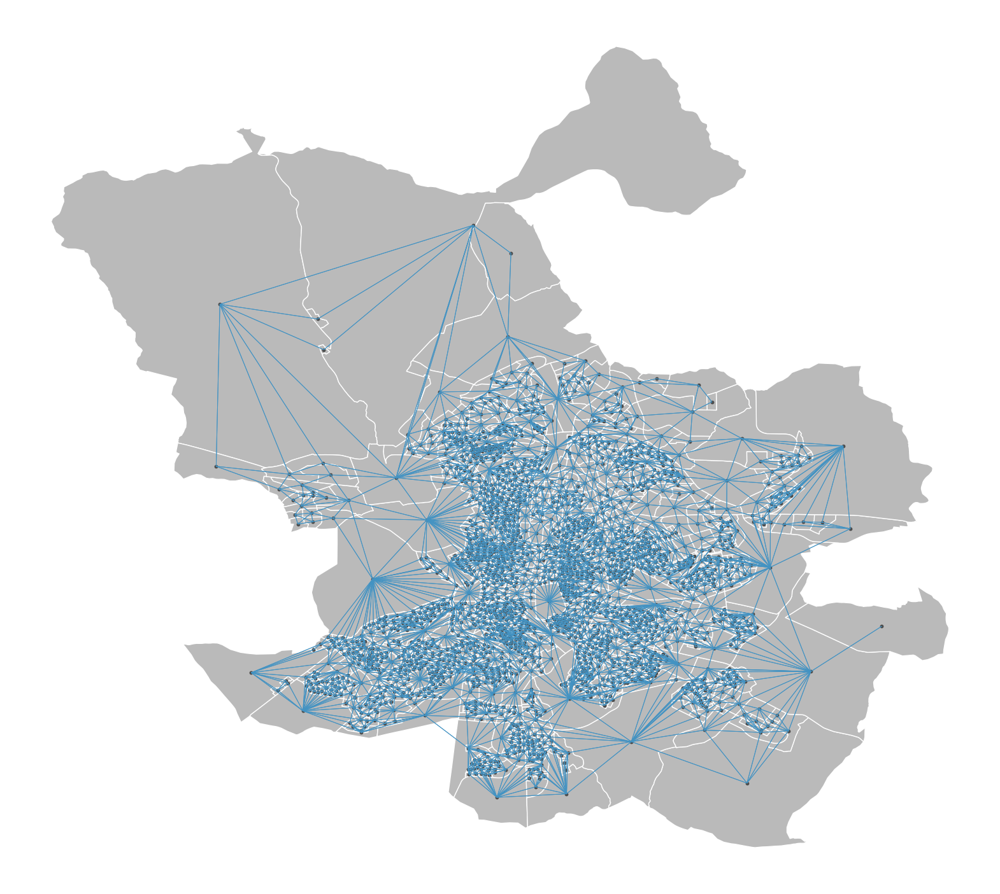

In [42]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plot_spatial_weights(wgt_q, census, ax=ax)

#### 2.6.2. Moran's I

[Tobler's first law of geography](https://en.wikipedia.org/wiki/Tobler%27s_first_law_of_geography#:~:text=The%20First%20Law%20of%20Geography,specifically%20for%20the%20inverse%20distance) states that everything is related to everything else, but near things are more related than distant things.

[Moran's I](https://en.wikipedia.org/wiki/Moran%27s_I) statistic quantifies how much near things are more related than distant things.


<img src="images/morans_i.png" width="850">

In [43]:
mi = esda.moran.Moran(orders_ct['count_norm'], wgt_q)
print("Moran's I: {0:.{1}f}".format(mi.I, 3))
print("Moran's E[I]: {0:.{1}f}".format(mi.EI, 3))
print("Moran's Var[I]: {0:.{1}f}".format(mi.VI_norm, 3))
print("p-value ",mi.p_sim)

Moran's I: 0.510
Moran's E[I]: -0.000
Moran's Var[I]: 0.000
p-value  0.001


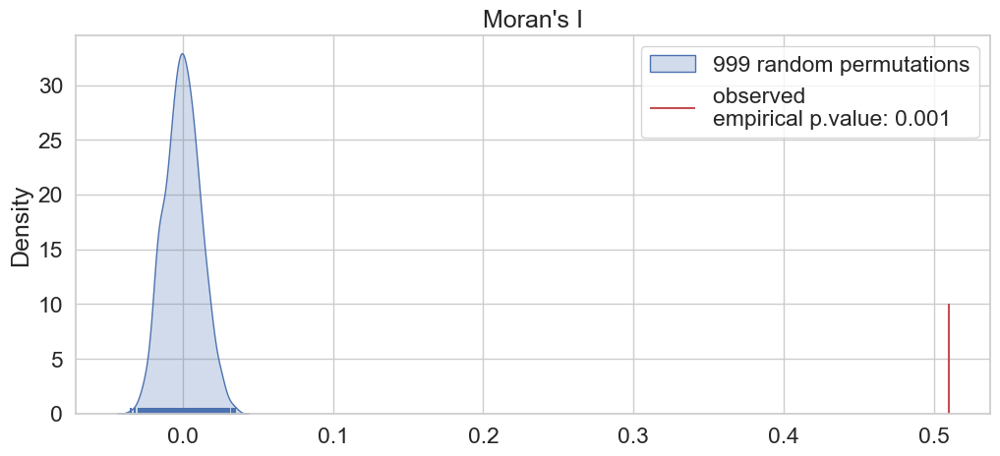

In [44]:
plt.figure(figsize=(12, 5))
sns.kdeplot(mi.sim, fill=True)
plt.vlines(mi.I, 0, 10, 'r')
plt.title("Moran's I")
plt.legend(["999 random permutations", "observed \nempirical p.value: " + str(round(mi.p_sim,3))])
plt.vlines(mi.sim, 0, 0.5)

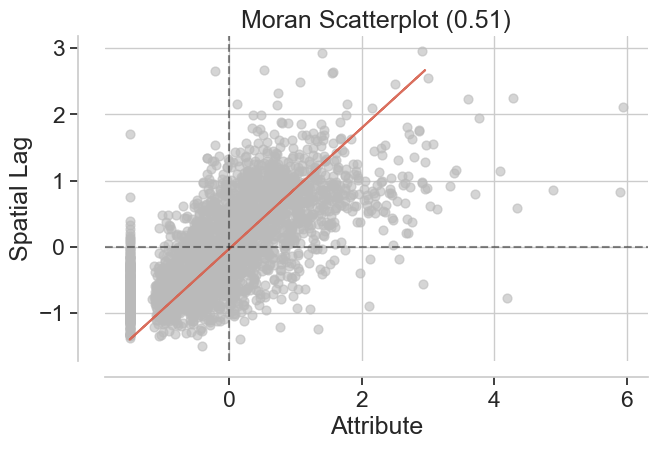

In [45]:
fig, ax = moran_scatterplot(mi, zstandard = True, aspect_equal=True)

### 2.7. Local spatial autocorrelation (Local Moran's I)

Moran’s I does not indicate areas within the map where specific types of values (e.g., high, low) are clustered, or instances of explicit dispersion. In other words, Moran’s I can tell us whether values in our map cluster together (or disperse) overall, but it will not inform us about where specific clusters (or outliers) are.

Local measures of spatial autocorrelation focus on the relationships between each observation and its surroundings, rather than providing a single summary of these relationships across the map. In this sense, they are not summary statistics but scores that allow us to learn more about the spatial structure in our data. 

(<Figure size 1500x700 with 2 Axes>, <Axes: >)

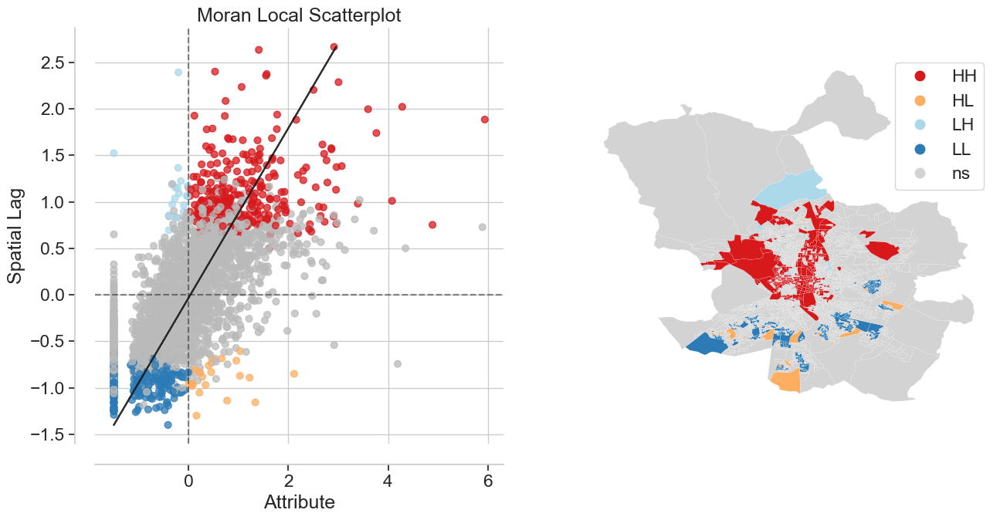

In [46]:
p = 0.01
fig, ax = plt.subplots(1,2, figsize = (15,7))
li = esda.moran.Moran_Local(orders_ct['count_norm'], wgt_q)
moran_scatterplot(li, p=p,  aspect_equal=False, ax = ax[0], scatter_kwds={'alpha':0.75})
lisa_cluster(li, orders_ct, ax = ax[1], p=p)

In [47]:
def assign_cluster(p_value, q, alpha):
    if p_value < alpha:
        if q == 1:
            return 'HH'
        elif q == 2:
            return 'LH'
        elif q == 3:
            return 'LL'
        elif q == 4:
            return 'HL'
    else:
        return 'Not significant'

orders_ct['local_moran_p_value'] = li.p_sim
orders_ct['local_moran_quadrant'] = li.q
orders_ct['cluster'] = orders_ct.apply(lambda row: assign_cluster(row['local_moran_p_value'], row['local_moran_quadrant'], 0.01), axis=1)
orders_ct.head(2)

,ccaa,CPRO,CMUN,dist,secc,count,geometry,t1_1,t2_1,t2_2,t3_1,t4_1,t4_2,t4_3,t5_1,t6_1,t7_1,t8_1,t9_1,t10_1,t11_1,t12_1,t13_1,t14_1,t15_1,t16_1,count_norm,local_moran_p_value,local_moran_quadrant,cluster
0,13,28,079,01,001,7,"POLYGON ((-3.71113 40.42075, -3.71176 40.42067, -3.71193 40.42064, -3.71189 40.42059, -3.71113 40.41990, -3.71086 40.41969, -3.71123 40.41949, -3.71145 40.41949, -3.71156 40.41949, -3.71157 40.419...",1159,0.5203,0.4797,47.3106,0.0863,0.6721,0.2416,0.1648,0.2381,0.0482,0.0425,0.6364,0.1129,0.4674,0.5269,0.0113,0.1813,0.2304,0.0585,6.039689,0.001,1,HH
1,13,28,079,01,002,4,"POLYGON ((-3.71015 40.42294, -3.71030 40.42282, -3.71057 40.42257, -3.71061 40.42252, -3.71067 40.42249, -3.71011 40.42165, -3.71001 40.42150, -3.70980 40.42123, -3.70965 40.42106, -3.70945 40.420...",888,0.5236,0.4764,43.2252,0.0484,0.8018,0.1498,0.2432,0.3660,0.0639,0.0627,0.6071,0.1182,0.5385,0.6107,0.0095,0.1160,0.2166,0.0521,4.504505,0.026,1,Not significant


In [48]:
Map(Layer(orders_ct, 
          style=color_category_style('cluster', palette=['#009B9E', '#A7D3D4', '#E4C1D9', '#C75DAB', '#f3f3f3'], cat=['LL', 'LH', 'HL', 'HH', 'Not significant'], opacity=0.5)))

In [49]:
census_vars = list(orders_ct.columns[7:-4])
test = orders_ct.groupby('cluster')[census_vars].mean()

#### Heatmap with relative differences with respect to the global mean

<Axes: ylabel='cluster'>

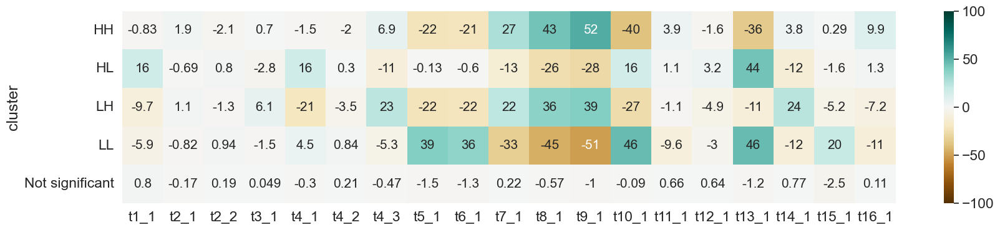

In [50]:
plt.figure(figsize=(20,4))
sns.heatmap((pd.DataFrame(test) - pd.DataFrame(orders_ct)[census_vars].mean())*100/pd.DataFrame(orders_ct)[census_vars].mean(), 
            vmin=-100, vmax=100, annot=True, annot_kws=dict(fontsize=15), cmap='BrBG')


In [51]:
test = test.reset_index().T
test.columns = test.iloc[0]
test = test.iloc[1:].reset_index()
test.columns.name = None
test.rename(columns = {'index':'vars'}).replace(census_dict['description'])

,vars,HH,HL,LH,LL,Not significant
0,Total Personas,1330.488889,1552.304348,1211.608696,1262.229167,1352.259671
1,Porcentaje de mujeres,0.545632,0.531987,0.541639,0.531327,0.534813
2,Porcentaje de hombres,0.454368,0.468013,0.458361,0.468673,0.465187
3,Edad media,44.909420,43.343009,47.332230,43.934775,44.620789
4,Porcentaje de personas menores de 16 años,0.127665,0.150326,0.103078,0.135563,0.129285
5,Porcentaje de personas entre 16 (incluido) y 64 (incluido) años,0.641792,0.656661,0.631630,0.660140,0.656076
6,Porcentaje de personas con más de 64 años,0.230546,0.193004,0.265287,0.204300,0.214641
7,Porcentaje extranjeros,0.115879,0.149130,0.115930,0.207605,0.147112
8,Porcentaje personas nacidas en el extranjero,0.187221,0.235878,0.186257,0.322479,0.234274
9,Porcentaje personas cursando estudios superiores (escur =08 09 10 11 12 ) sobre población de 16 y más,0.068848,0.046896,0.066048,0.035962,0.054156


### 2.8. Density-based clustering

**DBSCAN**

In [52]:
orders['x'] = orders.to_crs('epsg:32630').geometry.x
orders['y'] = orders.to_crs('epsg:32630').geometry.y

In [53]:
dbscan = DBSCAN(eps=300, min_samples=50)

In [54]:
dbscan.fit(orders[['x', 'y']])

DBSCAN(eps=300, min_samples=50)

In [55]:
pd.DataFrame(dbscan.labels_).value_counts()

-1     7643
 1      750
 6      607
 0      203
 3      184
 5      174
 10     169
 8      139
 9       88
 7       63
 2       53
 4       48
Name: count, dtype: int64

In [56]:
orders['cluster'] = list(map(lambda s: f'clust_{s}', dbscan.labels_))
orders.head()

,order_id,lat,lon,geometry,h3,x,y,cluster
0,0,40.419263,-3.719897,POINT (-3.71990 40.41926),89390cb1a37ffff,438926.998160,4.474542e+06,clust_-1
1,1,40.417093,-3.713083,POINT (-3.71308 40.41709),89390cb1b53ffff,439503.197192,4.474296e+06,clust_-1
2,2,40.416763,-3.716036,POINT (-3.71604 40.41676),89390cb1a27ffff,439252.358964,4.474262e+06,clust_-1
3,3,40.419703,-3.712296,POINT (-3.71230 40.41970),89390cb1bcfffff,439572.259430,4.474585e+06,clust_-1
4,4,40.419013,-3.719572,POINT (-3.71957 40.41901),89390cb1a37ffff,438954.369583,4.474514e+06,clust_-1


In [57]:
Map(Layer(orders, style=color_category_style('cluster', opacity=0.5, stroke_width=0, size=3)))

## 3. Understanding spatial drivers for your business performance

We have already identified some of the characteristics of areas of high and low demand through the local autocorrelation analysis. We can now delve into quantifying the impact of various census variables on historical demand. To accomplish this, we will train a simple linear regression model.

Please note that, for the sake of simplicity, we will not conduct a train-test split.

### 3.1. Correlation matrix

We start by taking a look at the correlation matrix.

In [58]:
corr = orders_ct[['count', 'count_norm', 't1_1',
       't2_1', 't2_2', 't3_1', 't4_1', 't4_2', 't4_3', 't5_1', 't6_1', 't7_1',
       't8_1', 't9_1', 't10_1', 't11_1', 't12_1', 't13_1', 't14_1', 't15_1',
       't16_1']].corr()

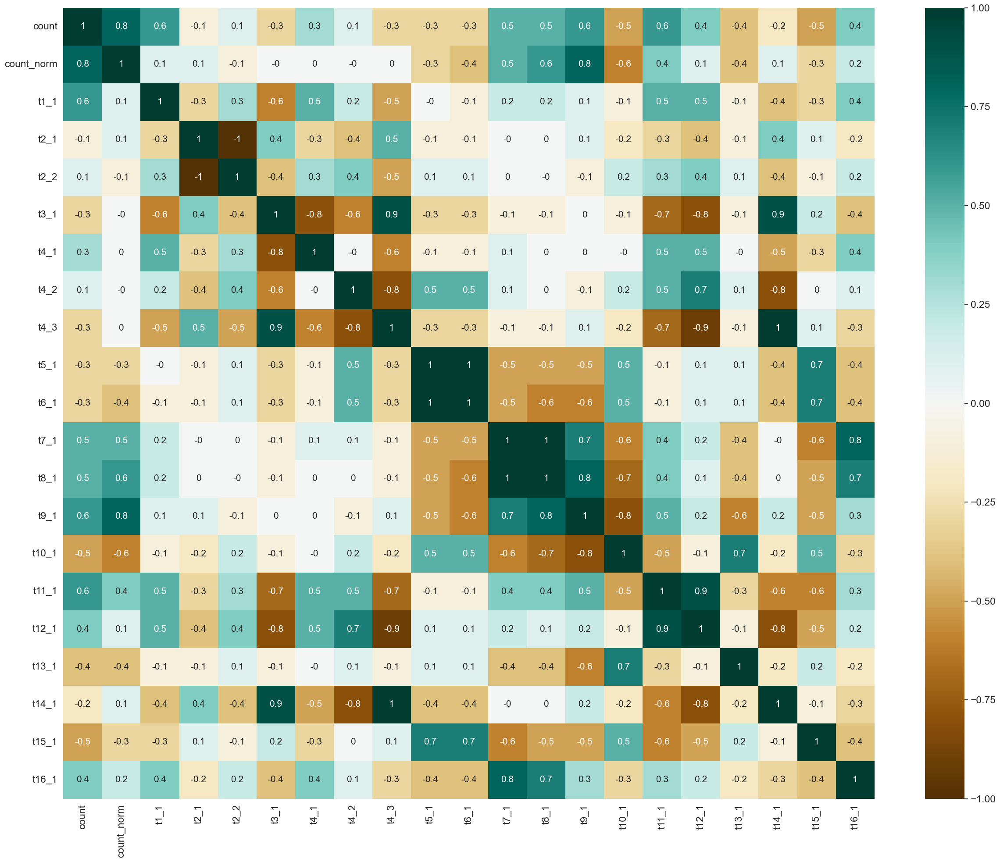

In [59]:
plt.figure(figsize=(25, 20))
sns.heatmap(corr.round(1), 
            xticklabels=corr.columns,
            yticklabels=corr.columns, 
            center = 0, cmap='BrBG', annot=True, annot_kws=dict(fontsize=15))
plt.tight_layout()

### 3.2. Regression analysis

In [60]:
predictors = ['t1_1', 't2_1', 't2_2', 't3_1', 't4_1', 't4_2', 't4_3', 't5_1', 't6_1', 't7_1',
              't8_1', 't9_1', 't10_1', 't11_1', 't12_1', 't13_1', 't14_1', 't15_1', 't16_1']

#### 3.2.1. Dimensionality reduction

In [61]:
pca = PCA()

In [62]:
scc = StandardScaler()

In [63]:
pca.fit(scc.fit_transform(orders_ct[predictors]))

PCA()

In [64]:
np.cumsum(pca.explained_variance_ratio_)

array([0.34170604, 0.64068714, 0.73383905, 0.80839394, 0.87192669,
       0.92419906, 0.95312147, 0.9713052 , 0.98269131, 0.99096938,
       0.995506  , 0.99778927, 0.99876123, 0.99935666, 0.99991833,
       0.99997642, 0.99999999, 1.        , 1.        ])

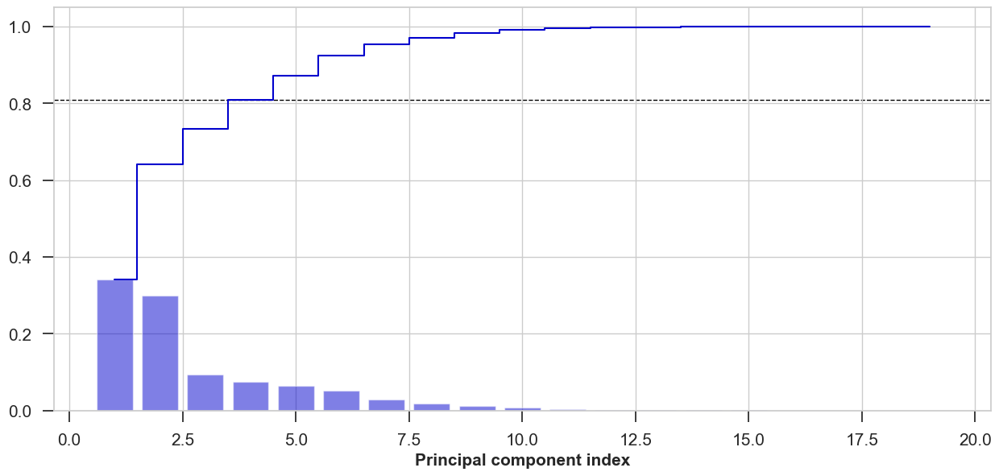

In [65]:
plot_pc_var(pca.explained_variance_ratio_, cum_var_thr = 0.8, textsize = 15, title = '')

In [66]:
proj_df = pd.DataFrame((pca.transform(scc.fit_transform(orders_ct[predictors]))[:, :4]),
                   columns=[f'pc_{i}' for i in range(4)])

proj_df.head()

,pc_0,pc_1,pc_2,pc_3
0,0.772471,-0.043249,-0.273175,1.647217
1,-1.409795,1.056459,-2.404915,2.728464
2,-1.548268,1.509703,-0.775322,3.221311
3,-0.031941,-0.218984,-0.342374,2.010821
4,-1.276347,-0.044381,-0.048812,2.990078


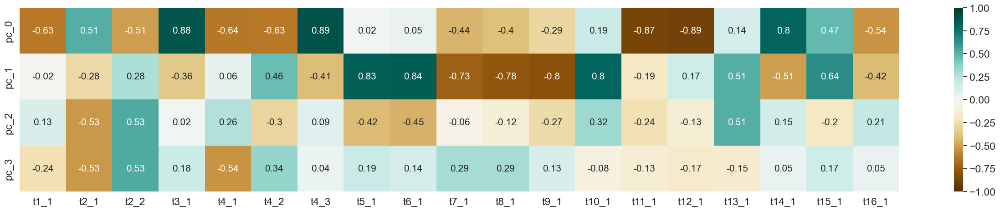

In [67]:
component_rel = pd.concat([proj_df, orders_ct[predictors]], axis=1).corr().loc[[f'pc_{i}' for i in range(4)], predictors]

plt.figure(figsize=(25, 5))
sns.heatmap(component_rel.round(2), center=0, cmap='BrBG', annot=True, annot_kws=dict(fontsize=15), 
            vmin=-1, vmax=1, )
plt.tight_layout()

#### 3.2.2. Generalized linear regression

In [68]:
sc = StandardScaler()
X = sc.fit_transform(proj_df)
X1 = sm.add_constant(X)
y = orders_ct['count'].values.reshape(-1, 1)

In [69]:
pr = sm.GLM(y, X1, 
            family=sm.families.Poisson(), 
            exposure = orders_ct['t1_1']).fit()
pr.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                      y   No. Observations:                 2443
Model:                            GLM   Df Residuals:                     2438
Model Family:                 Poisson   Df Model:                            4
Link Function:                    Log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -4764.0
Date:                Wed, 06 Sep 2023   Deviance:                       2532.0
Time:                        10:02:56   Pearson chi2:                 2.37e+03
No. Iterations:                     5   Pseudo R-squ. (CS):             0.5016
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -5.8938      0.011   -523.840      0.000      -5.916      -5.872
x1            -0.1438      0.009    -16.620      0.000      -0.161      -0.127
x2            -0.3639      0.011    -33.427      0.000      -0.385      -0.343
x3            -0.1925      0.011    -16.823      0.000      -0.215      -0.170
x4             0.0474      0.009      5.106      0.000       0.029       0.066
==============================================================================
"""

/var/folders/r6/833vqlws5c1dzd7d5r447kdc0000gp/T/ipykernel_48271/1828059689.py:94: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  fig.tight_layout(rect=[0, 0.03, 1, 0.95])


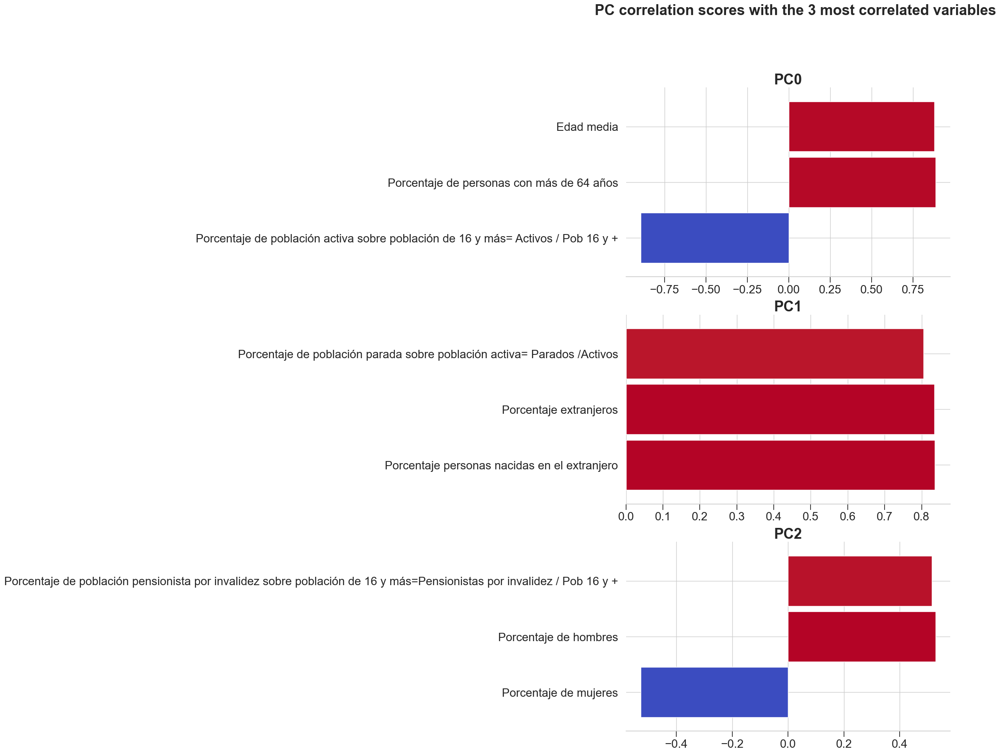

In [70]:
plot_pc_corr(orders_ct.join(proj_df), pca.explained_variance_ratio_,  predictors, census_dict,
             nrows = 3, nvars = 3, figsize_w = 10, figsize_h = 20, 
             var_exp_thr = 0.8, 
             textsize = 25, title = 'PC correlation scores with the 3 most correlated variables')

#### 3.2.3. Residual analysis

In [71]:
orders_ct['count_pred'] = pr.fittedvalues
orders_ct['count_pred_error'] = (orders_ct['count'] - orders_ct['count_pred']) / ((orders_ct['count'] + orders_ct['count_pred'])/2)

In [72]:
mi = esda.moran.Moran(orders_ct['count_pred_error'], wgt_q)
print("Moran's I: {0:.{1}f}".format(mi.I, 3))
print("Moran's E[I]: {0:.{1}f}".format(mi.EI, 3))
print("Moran's Var[I]: {0:.{1}f}".format(mi.VI_norm, 3))
print("p-value ",mi.p_sim)

Moran's I: 0.204
Moran's E[I]: -0.000
Moran's Var[I]: 0.000
p-value  0.001


In [73]:
orders_ct['count_pred_error'].describe(percentiles=[0.05, 0.25, 0.75, 0.95])

count    2443.000000
mean       -0.232021
std         0.745442
min        -2.000000
5%         -2.000000
25%        -0.399004
50%        -0.064995
75%         0.236104
95%         0.614445
max         1.575775
Name: count_pred_error, dtype: float64

In [74]:
Map(Layer(orders_ct, 
          style=color_bins_style('count_pred_error', breaks=[-10, -5, -2, 0, 2, 5, 10], palette=palettes.tropic, opacity=0.8)))

### 3.3. Geographically weighted regression

[Geographically weighted regression (GWR)](https://carto.com/blog/how-geographically-weighted-regression-works) quantifies the effect of different predictors on a target variable with geographical weights. GWR performs a local least squares regression for every input cell (polygon) in a continuous grid. Each regression will be calculated based on the data of each cell (polygon) and its user-defined neighborhood. Within that neighborhood, the data of the neighboring cells (polygons) could be assigned a weight dependent on the distance to the origin cell (polygon).

Be careful because this technique is computationally expensive and tends to overfit.

For further detail, check out the following [link](https://mgwr.readthedocs.io/en/latest/).

In [75]:
coords = list(zip(orders_ct.to_crs('epsg:32630').geometry.centroid.apply(lambda p: p.x),
                  orders_ct.to_crs('epsg:32630').geometry.centroid.apply(lambda p: p.y)))

In [76]:
model = GWR(coords, y, X, 
            bw = 20, 
            family = Poisson(), offset = np.log(orders_ct['t1_1']).values.reshape(-1,1), 
            constant = True, fixed=False, kernel='bisquare')

## Since this next step takes a while, we'll just load the precomputed results

#results = model.fit()
#pickle.dump(results, open('./data/gwr.pkl', 'wb'))
results = pickle.load(open('./data/gwr.pkl', 'rb'))
results.summary()

Model type                                                          Poisson
Number of observations:                                                2443
Number of covariates:                                                     5

Global Regression Results
---------------------------------------------------------------------------
Deviance:                                                          2531.977
Log-likelihood:                                                   -4763.995
AIC:                                                               9537.990
AICc:                                                              2542.002
BIC:                                                             -16486.817
Percent deviance explained:                                           0.402
Adj. percent deviance explained:                                      0.401

Variable                              Est.         SE  t(Est/SE)    p-value
------------------------------- ---------- ---------- ------

#### 3.3.1. Inference

In [77]:
pd.DataFrame(results.params, columns=['intercept']+list(proj_df.columns)).head()

,intercept,pc_0,pc_1,pc_2,pc_3
0,-6.338628,0.778167,-0.239174,-0.950835,0.576194
1,-5.177680,0.361743,-0.176809,0.005172,-0.026399
2,-5.308939,0.504946,0.013172,-0.042088,0.019677
3,-5.765754,0.944635,-0.310878,-0.244492,0.279413
4,-5.870601,0.495917,-0.637138,-0.573941,0.252418


In [78]:
pd.DataFrame(results.params, columns=['intercept']+list(proj_df.columns)).describe()

,intercept,pc_0,pc_1,pc_2,pc_3
count,2443.000000,2443.000000,2443.000000,2443.000000,2443.000000
mean,-5.901965,-0.265724,-0.288542,-0.033986,-0.045479
std,0.697976,0.614561,0.588491,0.458484,0.458958
min,-10.006338,-5.178726,-5.866497,-2.719079,-2.668680
25%,-6.238732,-0.462465,-0.552361,-0.256533,-0.219460
50%,-5.898760,-0.164593,-0.282221,-0.043409,-0.024283
75%,-5.532388,0.040684,0.012320,0.168297,0.181526
max,-1.565976,2.727301,3.159430,4.722421,2.718307


#### 3.3.2. Visualization of the spatially varying coefficients: let's discover different cities!

In [79]:
coeff_df = pd.DataFrame(results.params, columns=['intercept']+list(proj_df.columns))
coeff_df['geometry'] = orders_ct['geometry'].values
coeff_df.head(2)

,intercept,pc_0,pc_1,pc_2,pc_3,geometry
0,-6.338628,0.778167,-0.239174,-0.950835,0.576194,"POLYGON ((-3.71113 40.42075, -3.71176 40.42067, -3.71193 40.42064, -3.71189 40.42059, -3.71113 40.41990, -3.71086 40.41969, -3.71123 40.41949, -3.71145 40.41949, -3.71156 40.41949, -3.71157 40.419..."
1,-5.177680,0.361743,-0.176809,0.005172,-0.026399,"POLYGON ((-3.71015 40.42294, -3.71030 40.42282, -3.71057 40.42257, -3.71061 40.42252, -3.71067 40.42249, -3.71011 40.42165, -3.71001 40.42150, -3.70980 40.42123, -3.70965 40.42106, -3.70945 40.420..."


In [80]:
Map(Layer(coeff_df, geom_col='geometry', encode_data=False, 
          style=color_bins_style('pc_0', palette=palettes.earth, opacity=0.8)))

GWR is mainly recommended for testing for spatial non-stationarity, but not for modeling. Instead, different methods, like [spatially varying coefficient models](https://inlabru-org.github.io/inlabru/articles/svc.html) should be used.

## 4. Territory Creation Techniques

There are different techniques from clustering and optimization for creating territories. The key characteristic is that they normally need to be contigous territories (for every pair of polygons that belong to the same territory, one must be able to travel from one to the other without leaving the territory).

### 4.1. Weights

For territory optimization, we'd like to merge two census tracts only if they share at least one edge. These are called [rook weights](https://geographicdata.science/book/notebooks/04_spatial_weights.html).

In [81]:
wgt_r = weights.Rook.from_dataframe(orders_ct, geom_col='geometry')

In [82]:
wgt_r.histogram

[(1, 1),
 (2, 20),
 (3, 177),
 (4, 656),
 (5, 675),
 (6, 452),
 (7, 222),
 (8, 102),
 (9, 57),
 (10, 21),
 (11, 18),
 (12, 12),
 (13, 4),
 (14, 6),
 (15, 4),
 (16, 2),
 (17, 2),
 (18, 4),
 (19, 1),
 (20, 3),
 (21, 1),
 (22, 0),
 (23, 1),
 (24, 0),
 (25, 1),
 (26, 0),
 (27, 0),
 (28, 1)]

/opt/homebrew/lib/python3.11/site-packages/splot/_viz_libpysal_mpl.py:115: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  centroids_shp = gdf.centroid.values
/opt/homebrew/lib/python3.11/site-packages/splot/_viz_libpysal_mpl.py:154: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf.centroid.plot(ax=ax, **node_kws)


(<Figure size 2000x2000 with 1 Axes>, <Axes: >)

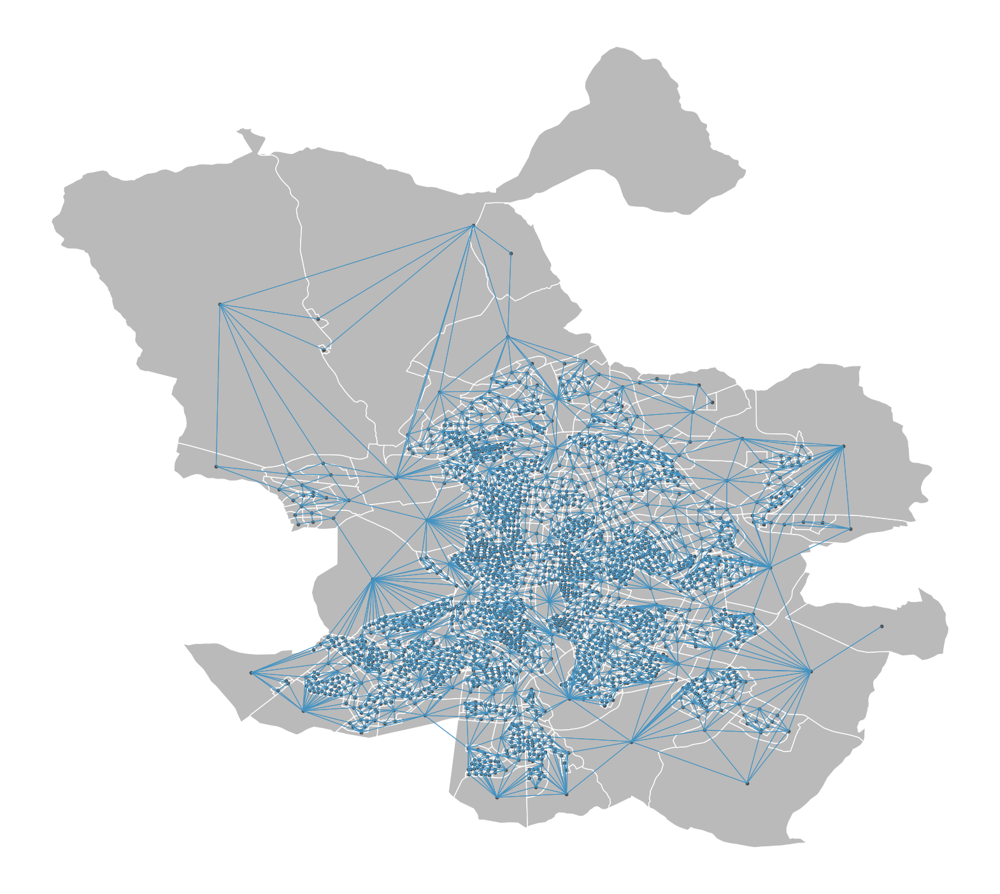

In [83]:
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
plot_spatial_weights(wgt_r, census, ax=ax)

### 4.2. Spatially constrained multivariate clustering. Similar and connected clusters

#### 4.2.1. Connectivity constrained agglomerative clustering

Connected clusters that are internally similar.

In [84]:
agg_clust = AgglomerativeClustering(n_clusters=10, connectivity=wgt_r.sparse)

In [85]:
agg_clust.fit(proj_df)

AgglomerativeClustering(connectivity=<2443x2443 sparse matrix of type '<class 'numpy.float64'>'
	with 13228 stored elements in Compressed Sparse Row format>,
                        n_clusters=10)

In [86]:
orders_ct['agg_cluster'] = list(map(lambda v: f'territory_{str.zfill(str(v+1), 2)}', agg_clust.labels_))
orders_ct.head()

,ccaa,CPRO,CMUN,dist,secc,count,geometry,t1_1,t2_1,t2_2,t3_1,t4_1,t4_2,t4_3,t5_1,t6_1,t7_1,t8_1,t9_1,t10_1,t11_1,t12_1,t13_1,t14_1,t15_1,t16_1,count_norm,local_moran_p_value,local_moran_quadrant,cluster,count_pred,count_pred_error,agg_cluster
0,13,28,079,01,001,7,"POLYGON ((-3.71113 40.42075, -3.71176 40.42067, -3.71193 40.42064, -3.71189 40.42059, -3.71113 40.41990, -3.71086 40.41969, -3.71123 40.41949, -3.71145 40.41949, -3.71156 40.41949, -3.71157 40.419...",1159,0.5203,0.4797,47.3106,0.0863,0.6721,0.2416,0.1648,0.2381,0.0482,0.0425,0.6364,0.1129,0.4674,0.5269,0.0113,0.1813,0.2304,0.0585,6.039689,0.001,1,HH,3.420145,0.687103,territory_04
1,13,28,079,01,002,4,"POLYGON ((-3.71015 40.42294, -3.71030 40.42282, -3.71057 40.42257, -3.71061 40.42252, -3.71067 40.42249, -3.71011 40.42165, -3.71001 40.42150, -3.70980 40.42123, -3.70965 40.42106, -3.70945 40.420...",888,0.5236,0.4764,43.2252,0.0484,0.8018,0.1498,0.2432,0.3660,0.0639,0.0627,0.6071,0.1182,0.5385,0.6107,0.0095,0.1160,0.2166,0.0521,4.504505,0.026,1,Not significant,3.561183,0.116071,territory_06
2,13,28,079,01,003,6,"POLYGON ((-3.70794 40.42153, -3.70779 40.42144, -3.70719 40.42106, -3.70702 40.42095, -3.70686 40.42085, -3.70641 40.42056, -3.70607 40.42035, -3.70595 40.42032, -3.70623 40.42020, -3.70632 40.420...",1743,0.4968,0.5032,43.7499,0.0700,0.7631,0.1670,0.2731,0.3798,0.0660,0.0592,0.5663,0.1126,0.5009,0.5645,0.0148,0.1370,0.2332,0.0574,3.442341,0.152,1,Not significant,5.296146,0.124618,territory_06
3,13,28,079,01,004,7,"POLYGON ((-3.71025 40.42079, -3.71020 40.42073, -3.70984 40.42039, -3.70981 40.42037, -3.70978 40.42035, -3.70933 40.41992, -3.70928 40.41988, -3.70931 40.41986, -3.70933 40.41984, -3.70934 40.419...",1273,0.5185,0.4815,46.5475,0.0731,0.7023,0.2247,0.1634,0.2577,0.0619,0.0559,0.6424,0.1284,0.4831,0.5542,0.0136,0.1754,0.2042,0.0585,5.498822,0.088,1,Not significant,4.138125,0.513888,territory_04
4,13,28,079,01,006,6,"POLYGON ((-3.70815 40.41906, -3.70818 40.41895, -3.70818 40.41894, -3.70822 40.41886, -3.70846 40.41839, -3.70847 40.41835, -3.70851 40.41828, -3.70852 40.41826, -3.70874 40.41790, -3.70876 40.417...",1712,0.4907,0.5093,46.5736,0.0718,0.7214,0.2068,0.1863,0.2769,0.0604,0.0516,0.6834,0.1005,0.5179,0.5758,0.0082,0.1687,0.1951,0.0585,3.504673,0.002,1,HH,5.793066,0.035094,territory_06


In [87]:
np.sort(orders_ct['agg_cluster'].unique())

array(['territory_01', 'territory_02', 'territory_03', 'territory_04',
       'territory_05', 'territory_06', 'territory_07', 'territory_08',
       'territory_09', 'territory_10'], dtype=object)

In [88]:
Map(Layer(orders_ct, 
          style=color_category_style('agg_cluster', cat=list(np.sort(orders_ct['agg_cluster'].unique())), opacity=0.75, palette=palettes.pastel),
          legends=color_category_legend('Cluster')))

In [89]:
orders_ct.groupby('agg_cluster').agg({'t1_1':'sum', 'count':'sum'})

,t1_1,count
agg_cluster,,
territory_01,83093,152
territory_02,620594,1241
territory_03,340601,549
territory_04,1186406,4963
territory_05,394390,1326
territory_06,100921,409
territory_07,183233,344
territory_08,133539,626
territory_09,161183,422


### 4.3. Spatially constrained multivariate and *balanced* clustering. Similar, *balanced* and connected clusters

In [90]:
proj_df['count'] = orders_ct['count'].values
proj_df['geometry'] = orders_ct['geometry'].values
proj_df = gpd.GeoDataFrame(proj_df, crs='epsg:4326')
proj_df.head()

,pc_0,pc_1,pc_2,pc_3,count,geometry
0,0.772471,-0.043249,-0.273175,1.647217,7,"POLYGON ((-3.71113 40.42075, -3.71176 40.42067, -3.71193 40.42064, -3.71189 40.42059, -3.71113 40.41990, -3.71086 40.41969, -3.71123 40.41949, -3.71145 40.41949, -3.71156 40.41949, -3.71157 40.419..."
1,-1.409795,1.056459,-2.404915,2.728464,4,"POLYGON ((-3.71015 40.42294, -3.71030 40.42282, -3.71057 40.42257, -3.71061 40.42252, -3.71067 40.42249, -3.71011 40.42165, -3.71001 40.42150, -3.70980 40.42123, -3.70965 40.42106, -3.70945 40.420..."
2,-1.548268,1.509703,-0.775322,3.221311,6,"POLYGON ((-3.70794 40.42153, -3.70779 40.42144, -3.70719 40.42106, -3.70702 40.42095, -3.70686 40.42085, -3.70641 40.42056, -3.70607 40.42035, -3.70595 40.42032, -3.70623 40.42020, -3.70632 40.420..."
3,-0.031941,-0.218984,-0.342374,2.010821,7,"POLYGON ((-3.71025 40.42079, -3.71020 40.42073, -3.70984 40.42039, -3.70981 40.42037, -3.70978 40.42035, -3.70933 40.41992, -3.70928 40.41988, -3.70931 40.41986, -3.70933 40.41984, -3.70934 40.419..."
4,-1.276347,-0.044381,-0.048812,2.990078,6,"POLYGON ((-3.70815 40.41906, -3.70818 40.41895, -3.70818 40.41894, -3.70822 40.41886, -3.70846 40.41839, -3.70847 40.41835, -3.70851 40.41828, -3.70852 40.41826, -3.70874 40.41790, -3.70876 40.417..."


#### 4.3.1. Districts 1 and 2

In [91]:
proj_df_f = proj_df.loc[orders_ct[orders_ct['dist'].isin(['01', '02'])].index].copy()
proj_df_f.head()

,pc_0,pc_1,pc_2,pc_3,count,geometry
0,0.772471,-0.043249,-0.273175,1.647217,7,"POLYGON ((-3.71113 40.42075, -3.71176 40.42067, -3.71193 40.42064, -3.71189 40.42059, -3.71113 40.41990, -3.71086 40.41969, -3.71123 40.41949, -3.71145 40.41949, -3.71156 40.41949, -3.71157 40.419..."
1,-1.409795,1.056459,-2.404915,2.728464,4,"POLYGON ((-3.71015 40.42294, -3.71030 40.42282, -3.71057 40.42257, -3.71061 40.42252, -3.71067 40.42249, -3.71011 40.42165, -3.71001 40.42150, -3.70980 40.42123, -3.70965 40.42106, -3.70945 40.420..."
2,-1.548268,1.509703,-0.775322,3.221311,6,"POLYGON ((-3.70794 40.42153, -3.70779 40.42144, -3.70719 40.42106, -3.70702 40.42095, -3.70686 40.42085, -3.70641 40.42056, -3.70607 40.42035, -3.70595 40.42032, -3.70623 40.42020, -3.70632 40.420..."
3,-0.031941,-0.218984,-0.342374,2.010821,7,"POLYGON ((-3.71025 40.42079, -3.71020 40.42073, -3.70984 40.42039, -3.70981 40.42037, -3.70978 40.42035, -3.70933 40.41992, -3.70928 40.41988, -3.70931 40.41986, -3.70933 40.41984, -3.70934 40.419..."
4,-1.276347,-0.044381,-0.048812,2.990078,6,"POLYGON ((-3.70815 40.41906, -3.70818 40.41895, -3.70818 40.41894, -3.70822 40.41886, -3.70846 40.41839, -3.70847 40.41835, -3.70851 40.41828, -3.70852 40.41826, -3.70874 40.41790, -3.70876 40.417..."


In [92]:
wgt_r_f = weights.Rook.from_dataframe(proj_df_f, geom_col='geometry')

In [93]:
orders_ct.loc[orders_ct['dist'].isin(['01', '02']), 'count'].sum()

1115

In [94]:
model = MaxPHeuristic(proj_df_f, 
                      wgt_r_f, 
                      attrs_name = list(proj_df_f.columns[:-1]), 
                      threshold_name = 'count', 
                      threshold = 180,
                      #max_iterations_construction=2,
                      verbose=True)

In [95]:
model.solve()

max_p:  6
number of good partitions: 6
0
totalWithinRegionDistance after SA: 
32773.93352670069
totalWithinRegionDistance after SA: 
32684.5967261072
totalWithinRegionDistance after SA: 
32935.39650068143
totalWithinRegionDistance after SA: 
30533.248056574063
totalWithinRegionDistance after SA: 
32598.20503514453
totalWithinRegionDistance after SA: 
31103.17640358299
totalWithinRegionDistance after SA: 
32991.3452497694
totalWithinRegionDistance after SA: 
29627.08172112784
totalWithinRegionDistance after SA: 
31672.701197954186
totalWithinRegionDistance after SA: 
31245.60089979592
1
totalWithinRegionDistance after SA: 
32016.113580959725
totalWithinRegionDistance after SA: 
32118.763220943947
totalWithinRegionDistance after SA: 
32314.23522374593
totalWithinRegionDistance after SA: 
32347.641298843424
totalWithinRegionDistance after SA: 
32595.36822949186
totalWithinRegionDistance after SA: 
31835.612016211722
totalWithinRegionDistance after SA: 
32304.9078746054
totalWithinRegionDi

In [96]:
proj_df_f['tcluster'] = list(map(lambda v: f'territory_{str.zfill(str(v), 2)}', model.labels_))
proj_df_f.head()

,pc_0,pc_1,pc_2,pc_3,count,geometry,tcluster
0,0.772471,-0.043249,-0.273175,1.647217,7,"POLYGON ((-3.71113 40.42075, -3.71176 40.42067, -3.71193 40.42064, -3.71189 40.42059, -3.71113 40.41990, -3.71086 40.41969, -3.71123 40.41949, -3.71145 40.41949, -3.71156 40.41949, -3.71157 40.419...",territory_05
1,-1.409795,1.056459,-2.404915,2.728464,4,"POLYGON ((-3.71015 40.42294, -3.71030 40.42282, -3.71057 40.42257, -3.71061 40.42252, -3.71067 40.42249, -3.71011 40.42165, -3.71001 40.42150, -3.70980 40.42123, -3.70965 40.42106, -3.70945 40.420...",territory_05
2,-1.548268,1.509703,-0.775322,3.221311,6,"POLYGON ((-3.70794 40.42153, -3.70779 40.42144, -3.70719 40.42106, -3.70702 40.42095, -3.70686 40.42085, -3.70641 40.42056, -3.70607 40.42035, -3.70595 40.42032, -3.70623 40.42020, -3.70632 40.420...",territory_02
3,-0.031941,-0.218984,-0.342374,2.010821,7,"POLYGON ((-3.71025 40.42079, -3.71020 40.42073, -3.70984 40.42039, -3.70981 40.42037, -3.70978 40.42035, -3.70933 40.41992, -3.70928 40.41988, -3.70931 40.41986, -3.70933 40.41984, -3.70934 40.419...",territory_05
4,-1.276347,-0.044381,-0.048812,2.990078,6,"POLYGON ((-3.70815 40.41906, -3.70818 40.41895, -3.70818 40.41894, -3.70822 40.41886, -3.70846 40.41839, -3.70847 40.41835, -3.70851 40.41828, -3.70852 40.41826, -3.70874 40.41790, -3.70876 40.417...",territory_05


In [97]:
Map(Layer(proj_df_f, 
          style=color_category_style('tcluster', opacity=0.75, cat=list(np.sort(proj_df_f['tcluster'].unique())))))

In [98]:
proj_df_f.groupby('tcluster').agg({'count':'sum'})

,count
tcluster,
territory_01,183
territory_02,204
territory_03,181
territory_04,183
territory_05,182
territory_06,182


#### 4.3.2. Madrid city

In [99]:
orders_ct.shape

(2443, 33)

In [100]:
orders_ct['count'].sum()

10121

In [101]:
list(proj_df.columns[:-1])

['pc_0', 'pc_1', 'pc_2', 'pc_3', 'count']

In [102]:
model = MaxPHeuristic(proj_df, 
                      wgt_r, 
                      attrs_name = list(proj_df.columns[:-1]), 
                      threshold_name = 'count', 
                      threshold = 1800,
                      verbose=True)

## Since this next step takes a while, we'll just load the precomputed results

#model.solve()
#proj_df['tcluster'] = list(map(lambda v: f'territory_{str.zfill(str(v), 2)}', model.labels_))
#proj_df.to_csv('data/proj_census_tracts_max_p.csv', index=False)

proj_df = pd.read_csv('data/proj_census_tracts_max_p.csv')
proj_df = gpd.GeoDataFrame(proj_df, geometry = gpd.GeoSeries.from_wkt(proj_df['geometry']))
proj_df.head()

,pc_1,pc_2,pc_3,pc_4,pc_5,pc_6,count,geometry,tcluster
0,0.772471,-0.043249,-0.273175,1.647217,-0.634813,0.260559,7,"POLYGON ((-3.71113 40.42075, -3.71176 40.42067, -3.71193 40.42064, -3.71189 40.42059, -3.71113 40.41990, -3.71086 40.41969, -3.71123 40.41949, -3.71145 40.41949, -3.71156 40.41949, -3.71157 40.419...",territory_02
1,-1.409795,1.056459,-2.404915,2.728464,-0.084549,-1.221060,4,"POLYGON ((-3.71015 40.42294, -3.71030 40.42282, -3.71057 40.42257, -3.71061 40.42252, -3.71067 40.42249, -3.71011 40.42165, -3.71001 40.42150, -3.70980 40.42123, -3.70965 40.42106, -3.70945 40.420...",territory_05
2,-1.548268,1.509703,-0.775322,3.221311,-0.222092,0.295571,6,"POLYGON ((-3.70794 40.42153, -3.70779 40.42144, -3.70719 40.42106, -3.70702 40.42095, -3.70686 40.42085, -3.70641 40.42056, -3.70607 40.42035, -3.70595 40.42032, -3.70623 40.42020, -3.70632 40.420...",territory_05
3,-0.031941,-0.218984,-0.342374,2.010821,-0.294002,-0.421021,7,"POLYGON ((-3.71025 40.42079, -3.71020 40.42073, -3.70984 40.42039, -3.70981 40.42037, -3.70978 40.42035, -3.70933 40.41992, -3.70928 40.41988, -3.70931 40.41986, -3.70933 40.41984, -3.70934 40.419...",territory_02
4,-1.276347,-0.044381,-0.048812,2.990078,-1.495382,0.265992,6,"POLYGON ((-3.70815 40.41906, -3.70818 40.41895, -3.70818 40.41894, -3.70822 40.41886, -3.70846 40.41839, -3.70847 40.41835, -3.70851 40.41828, -3.70852 40.41826, -3.70874 40.41790, -3.70876 40.417...",territory_02


In [103]:
Map(Layer(proj_df, 
          style=color_category_style('tcluster', opacity=0.75, cat=list(np.sort(proj_df['tcluster'].unique())))))

In [104]:
proj_df.groupby('tcluster').agg({'count':'sum'})

,count
tcluster,
territory_01,1801
territory_02,2582
territory_03,1801
territory_04,2134
territory_05,1803


### 4.4. Two-layer territory management. Balancing workload and maximum distance

See [this use case example](https://carto.com/developers/cartoframes/examples/#example-two-layer-territory-management).